### Notebook presents usage of layoutParser (Detectron2) backend for bounding box detection.
No OCR results are visualized, as this backend detects only blocks of text in document. Comparison of different models is presented. 

In [59]:
import os
while 'ipython' in os.getcwd():
    os.chdir("../")

import warnings
warnings.filterwarnings('ignore')

from pathlib import Path
from IPython.core.display import HTML
from typing import Tuple

import matplotlib.pyplot as plt

from mim_ocr.backends.layout_parser import LayoutParserBackend, MODEL_CATALOG
from mim_ocr.visualization.visualize_result import visualize_ocr_result, _generate_box_type_color_mapping
from mim_ocr.image import open_image

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [60]:
THRESHOLD = 30.


In [61]:
samples_dir = Path('sample_data')


In [62]:
parsers = [LayoutParserBackend(model_id) for model_id, _ in enumerate(MODEL_CATALOG)]


The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
The checkpoint state_dict contains keys that are not used by the model:
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}
The checkpoint state_dict contains keys that are not used by the model:
  pixel_mean
  pixel_std
  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


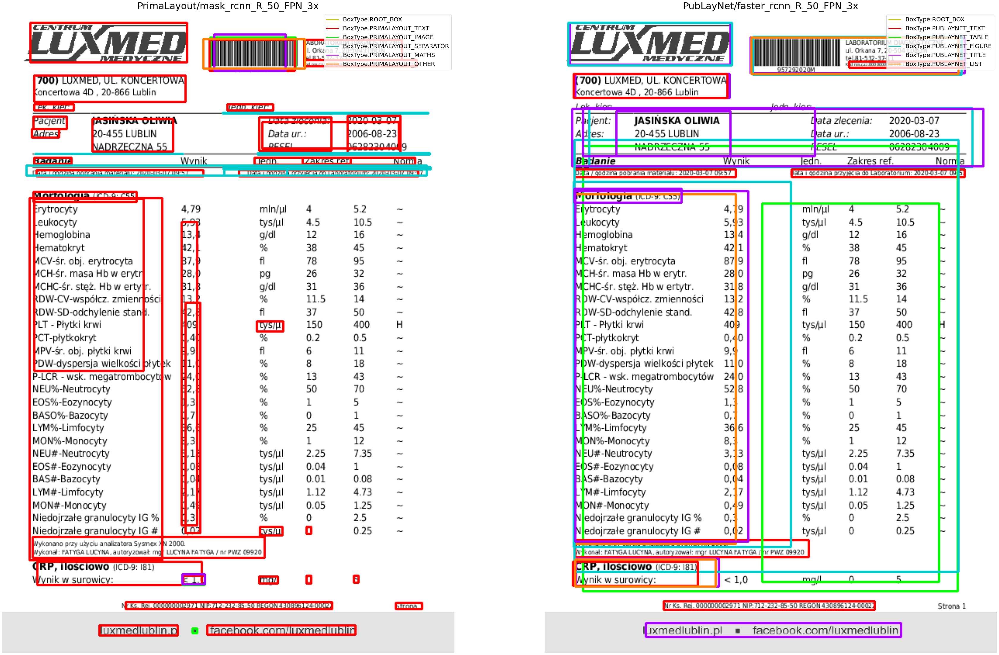

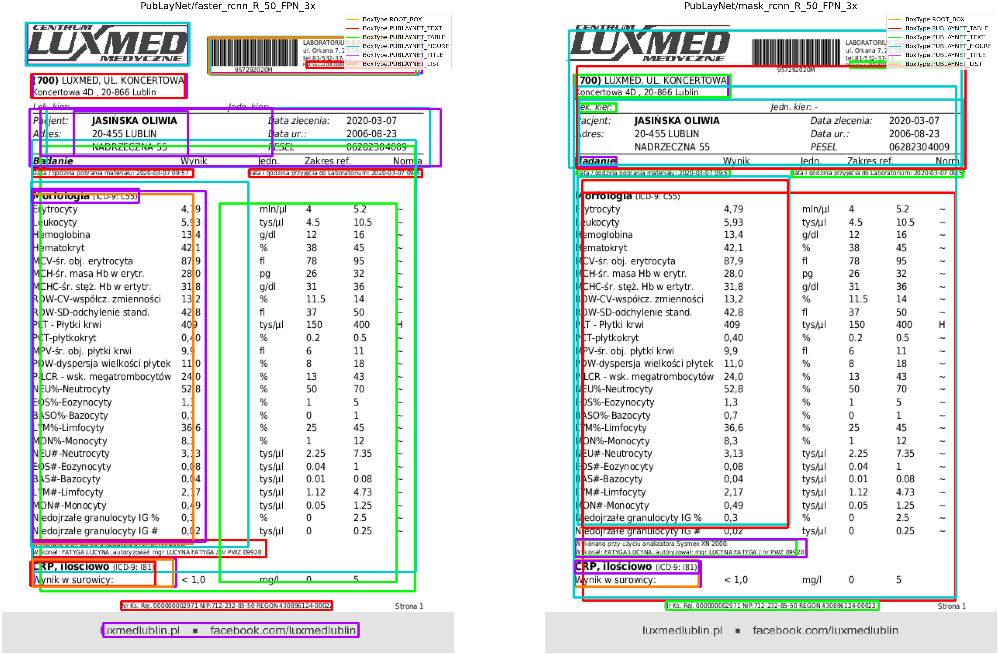

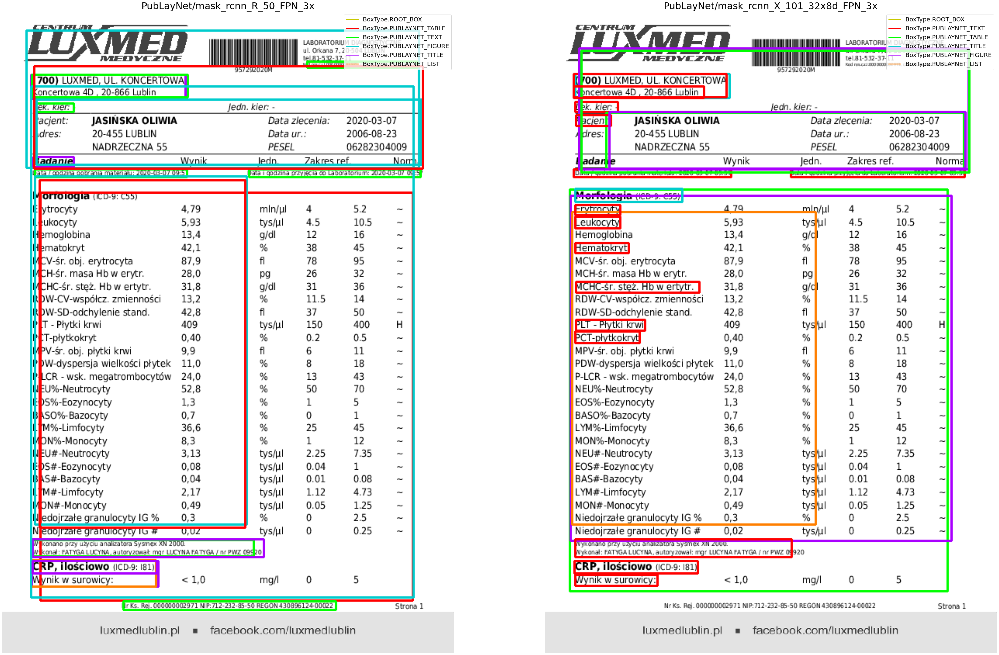

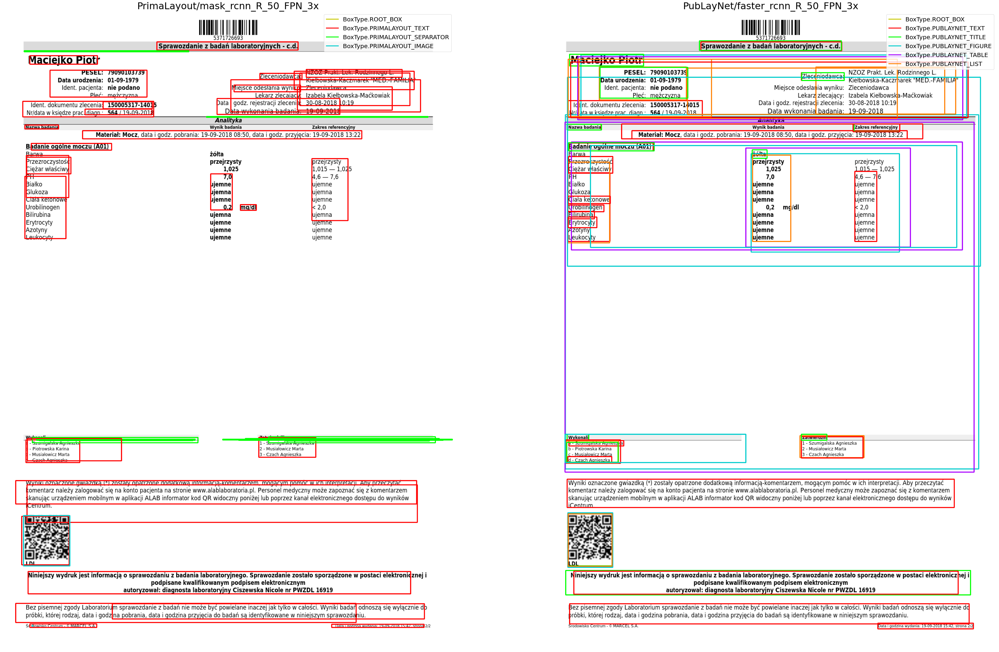

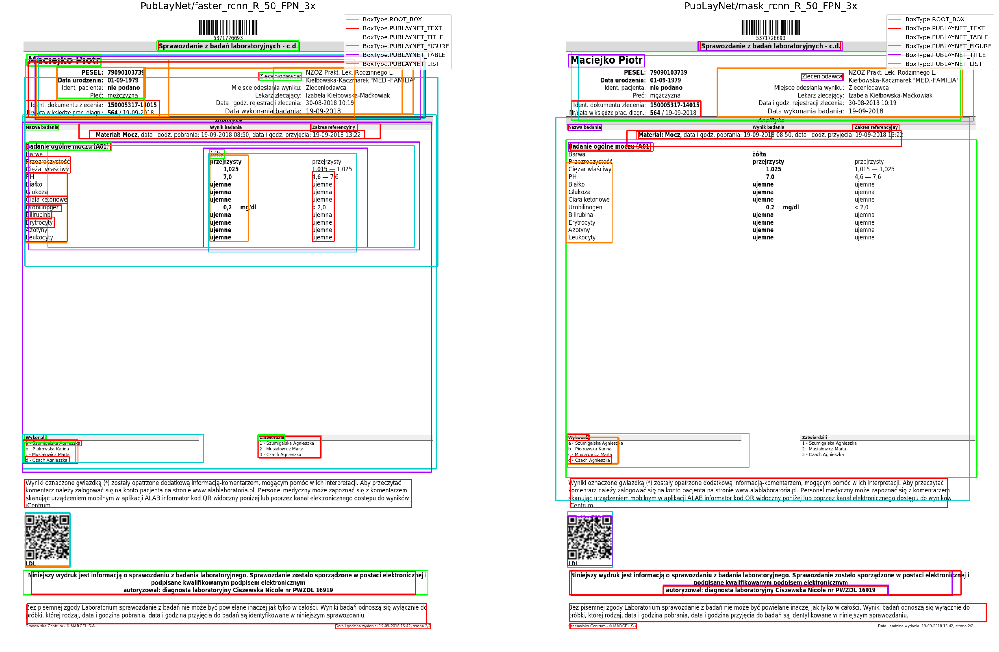

...

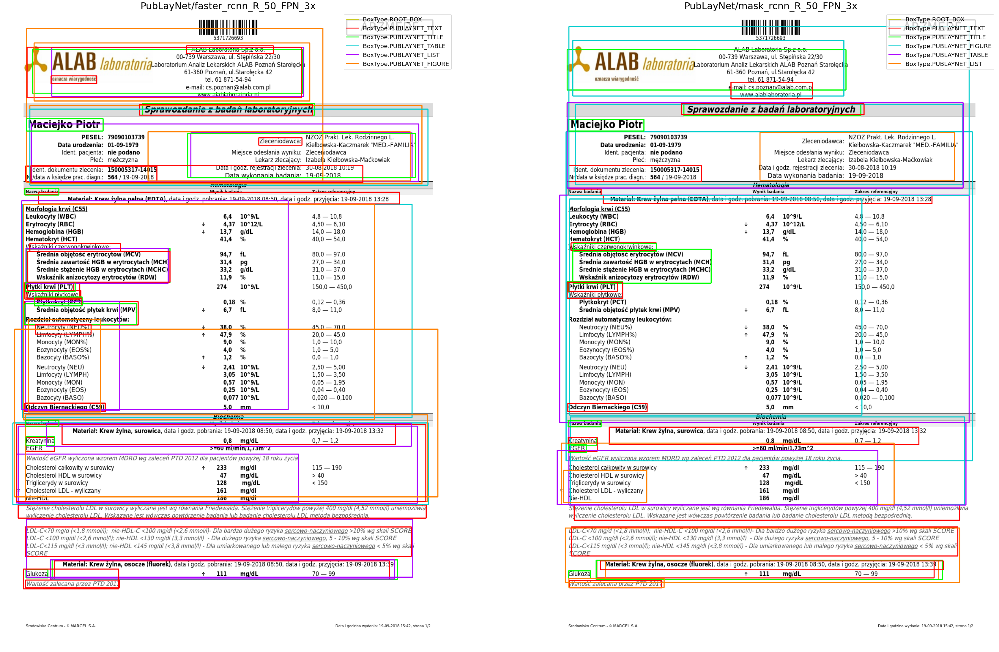

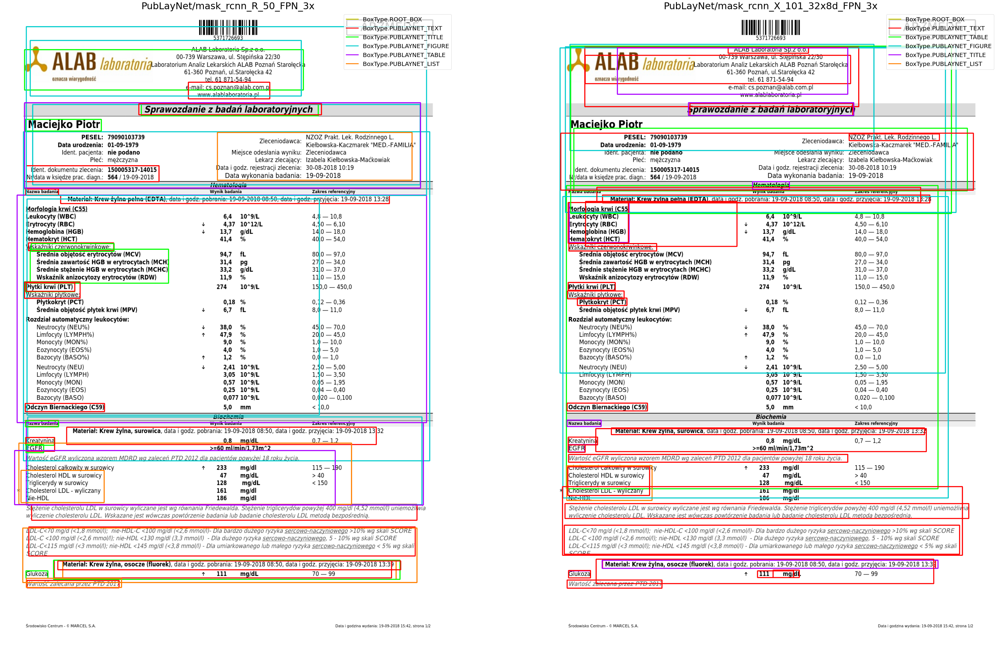

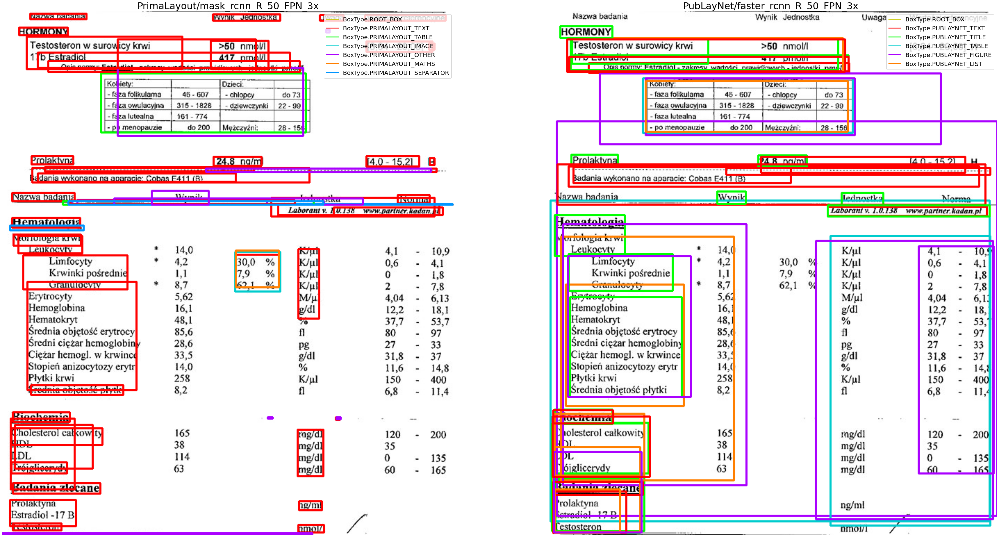

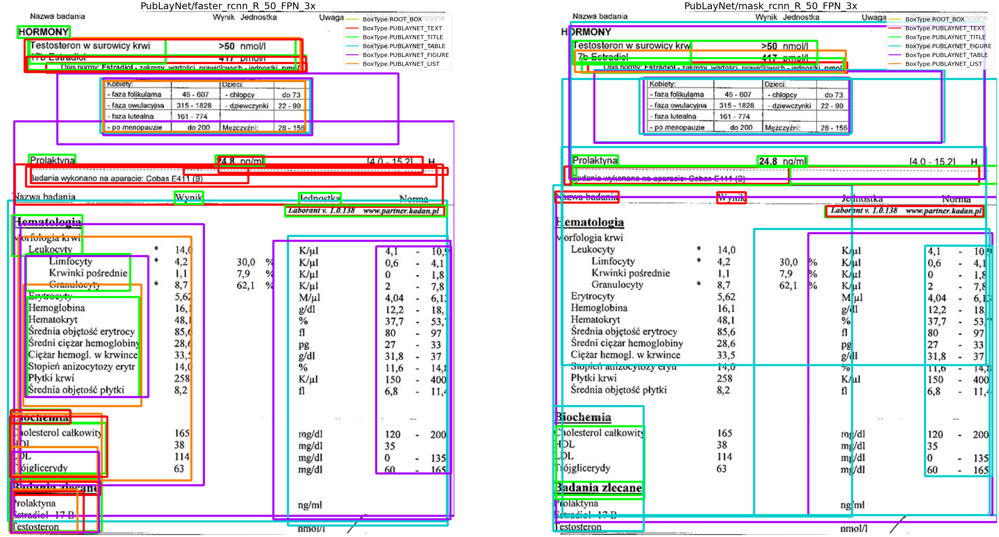

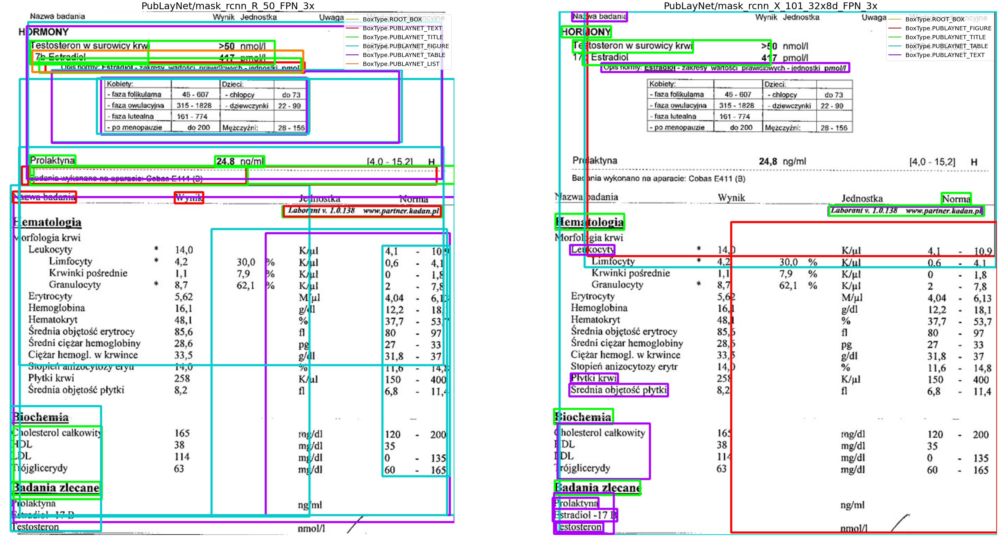

In [63]:
def convert_color(color: Tuple[int, int, int]) -> Tuple[float, float, float]:
    return tuple(v / 255. for v in color)


plt.rcParams['figure.figsize'] = (60, 80)
for path in samples_dir.iterdir():
    if not path.is_file():
        continue

    img = open_image(path)

    display(HTML(f'<h3> {path} </h3>'))

    for i in range(3):
        # display(HTML(f'<h3> {path} </h3>'))
        _, axs = plt.subplots(1, 2)
        for j in range(2):
            ax = axs[j]
            parser = parsers[i+j]
            layout = parser.run_ocr_to_box(img)
            colors = {box_type: convert_color(color)
                      for box_type, color in _generate_box_type_color_mapping(layout).items()}

            vis = visualize_ocr_result(img, layout, only_original=True)

            ax.imshow(vis)
            ax.axis('off')
            ax.set_title(parser.model_path, fontsize=32)
            labels, legend = zip(*[(label, plt.Line2D([0], [0], color=col, linewidth=3))
                                 for label, col in colors.items()])
            ax.legend(legend, labels, prop={'size': 20})

            # plot_layout_parser_result(img, parser, ax, treshold=)

        plt.show()
